In [1]:
import os
import scanpy as sc
import gc

In [2]:
#load colors for cell types 

In [3]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
#%matplotlib inline
sc.settings.figdir = "supplementary_celltype_figs"
sc.settings.set_figure_params(dpi=100,  dpi_save=300, facecolor="white", frameon=False, figsize=(22,22))
 

In [4]:
colors2 = { "scrna": "#F8F4E3",
             "xenium": "#D23C3C"
          }

 


In [5]:
BASE = '/lustre/scratch124/cellgen/haniffa/projects/adult_skin_v1/nobackup_output/subcluster2000_v7/'


# for x in sorted(os.listdir(BASE)):
#     print(x)

adata_Fibroblast.h5ad
adata_Fibroblast.h5ad.paga
adata_ILC.h5ad
adata_ILC.h5ad.paga
adata_KC.h5ad
adata_KC.h5ad.paga
adata_KC_HF.h5ad
adata_Myeloid.h5ad
adata_Myeloid.h5ad.paga
adata_Other.h5ad
adata_Other.h5ad.paga
adata_Schwann.h5ad
adata_Schwann.h5ad.paga
adata_Sweat gland.h5ad
adata_Sweat gland.h5ad.paga
adata_T.h5ad
adata_T.h5ad.6000
adata_T.h5ad.paga
adata_T.h5ad.paga2
adata_T.h5ad.paga3
adata_T.h5ad.paga6000
adata_T.h5ad2
adata_VE_Pericyte_muscle.h5ad
adata_VE_Pericyte_muscle.h5ad.paga
adata_hf.h5ad.paga
adata_sebo.h5ad.paga


In [15]:
import pickle

file_path = '/nfs/team298/ls34/color_for_adult_skin2.pkl'

# Load the dict back
with open(file_path, 'rb') as file:
    colors = pickle.load(file)
    
        

adata_Fibroblast.h5ad
adata_Fibroblast.h5ad.paga
adata_ILC.h5ad
adata_ILC.h5ad.paga
adata_KC.h5ad
adata_KC.h5ad.paga
adata_KC_HF.h5ad
adata_Myeloid.h5ad
adata_Myeloid.h5ad.paga
adata_Other.h5ad
adata_Other.h5ad.paga
adata_Schwann.h5ad
adata_Schwann.h5ad.paga
adata_Sweat gland.h5ad
adata_Sweat gland.h5ad.paga
adata_T.h5ad
adata_T.h5ad.6000
adata_T.h5ad.paga
(339618, 4993)


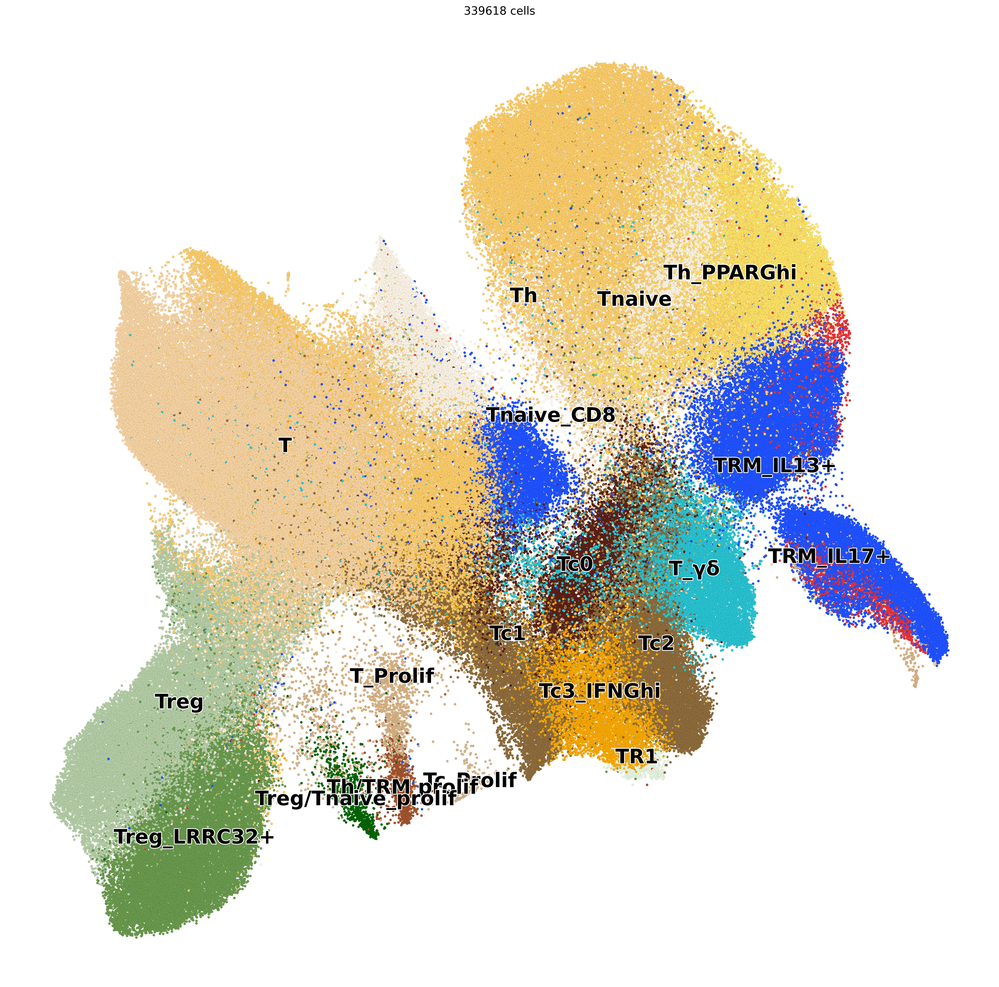

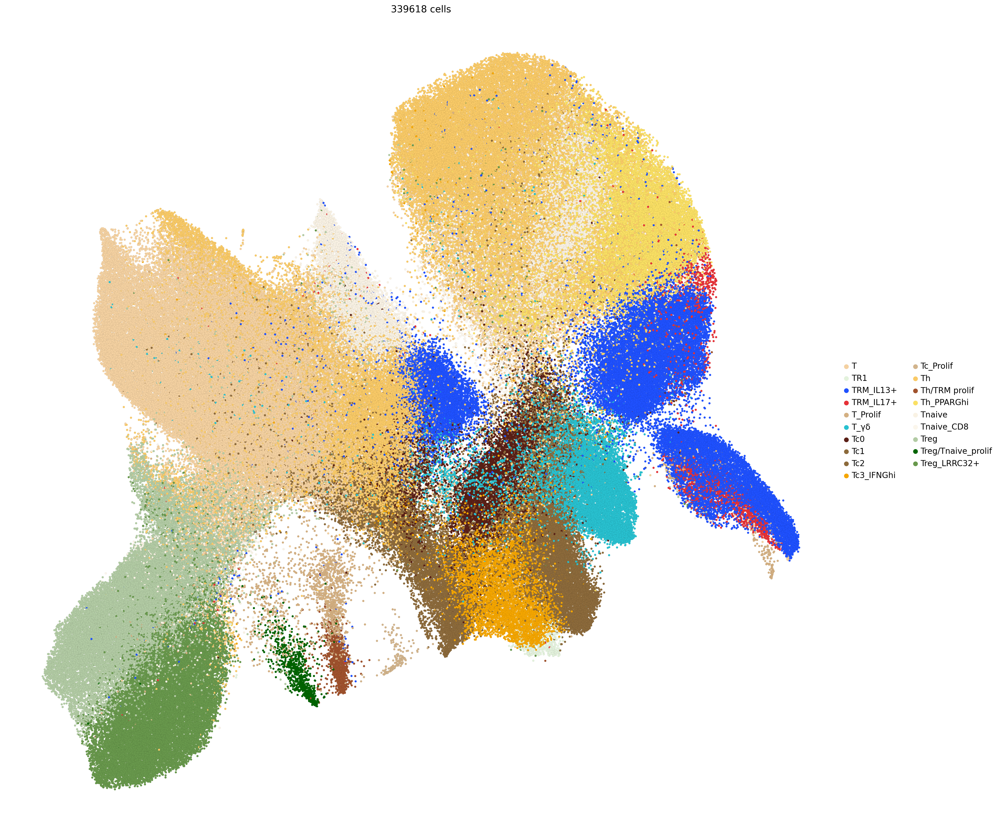

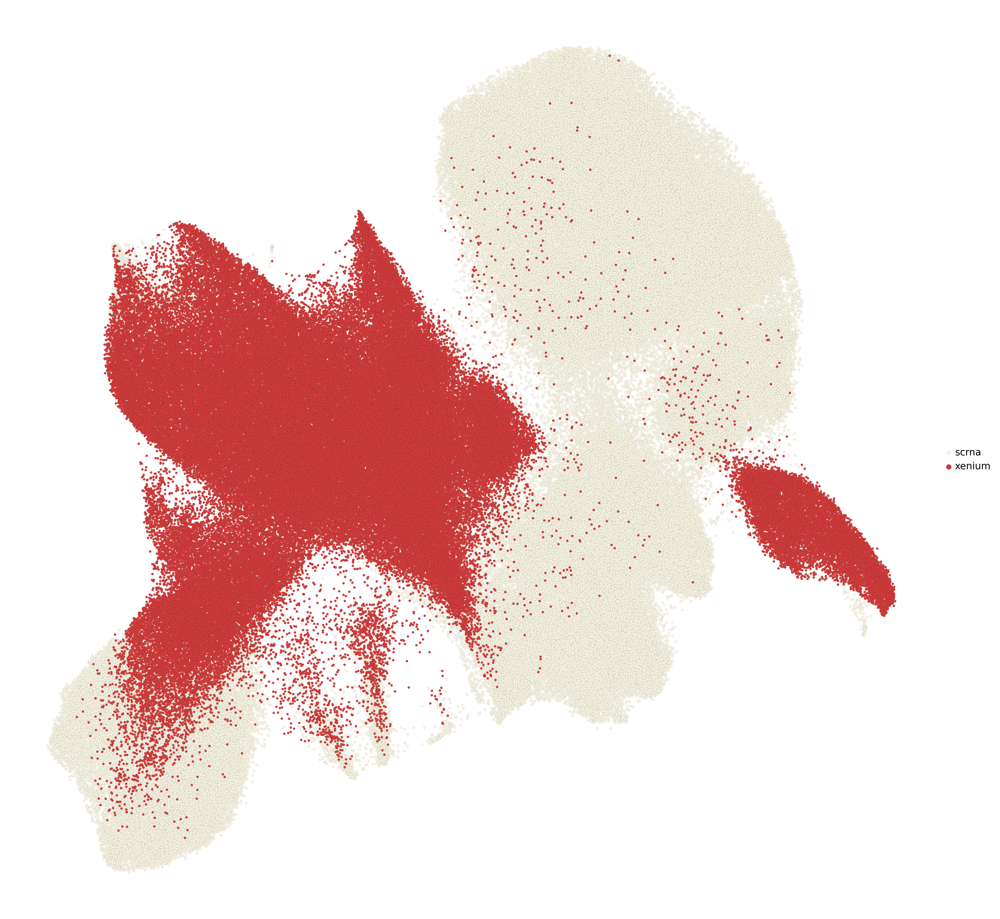

adata_T.h5ad.paga2
adata_T.h5ad.paga3
adata_T.h5ad.paga6000
adata_T.h5ad2
adata_VE_Pericyte_muscle.h5ad
adata_VE_Pericyte_muscle.h5ad.paga
adata_hf.h5ad.paga
adata_sebo.h5ad.paga


In [19]:
BASE = '/lustre/scratch124/cellgen/haniffa/projects/adult_skin_v1/nobackup_output/subcluster2000_v7/'

for x in sorted(os.listdir(BASE)):
    print(x)
    if  x == "adata_T.h5ad.paga":
        if "T." not in x:
            continue
        adata_i=sc.read_h5ad(BASE+x)
       
        print(adata_i.shape)
        if adata_i.shape[0]<60_000:
            SIZE=100
            LINE_SIZE = 0.1
            FONTSIZE=28
        elif  adata_i.shape[0]<100_000:
            SIZE=38
            LINE_SIZE = 0.04
            FONTSIZE=12
        else:
            SIZE=38
            LINE_SIZE = 0.04
            FONTSIZE=25
        adata_i.obs['lvl5_annotation'] = adata_i.obs['lvl5_annotation'].astype('category')
        adata_i.uns['lvl5_annotation_colors'] = [
            colors.get(cat, '#D3D3D3')  
            for cat in adata_i.obs['lvl5_annotation'].cat.categories
            ]
#         sc.pl.umap(
#             adata_i,#[adata.obs["lvl4_annotation"].isin(counts[counts >=50].index)],
#             color=[  "lvl5_annotation", ],
#             show=True,
#             frameon=False,
#             legend_loc= "on data",
#             legend_fontsize=FONTSIZE,
#             s=SIZE,
#            title=str(adata_i.shape[0])+" cells",
#             legend_fontoutline=2,
#              linewidth=LINE_SIZE*0.5,
#             edgecolor='black',
#             save=f"{x}_umap_paga_biggertext.pdf",

#         )
        sc.pl.umap(
            adata_i,#[adata.obs["lvl4_annotation"].isin(counts[counts >=50].index)],
            color=[  "lvl5_annotation", ],
            show=True,
            frameon=False,
            legend_loc= "on data",
            legend_fontsize=FONTSIZE,
            s=SIZE,
           title=str(adata_i.shape[0])+" cells",
            legend_fontoutline=2,
             linewidth=LINE_SIZE*0.5,
            edgecolor='black',
            save=f"{x}_umap_paga.pdf",

        )
        sc.pl.umap(
            adata_i,#[adata.obs["lvl4_annotation"].isin(counts[counts >=50].index)],
            color=[  "lvl5_annotation", ],
            show=True,
            frameon=False,
            #legend_loc= "on data",
            legend_fontsize=12,
            s=SIZE,
           title=str(adata_i.shape[0])+" cells",
            legend_fontoutline=2,
             linewidth=LINE_SIZE*0.5,
            edgecolor='black',
            save=f"{x}_umap_paga_legend.pdf",

        )
        adata_i.obs['tech'] =adata_i.obs['tech'] .astype('category')
        adata_i.uns['tech_colors'] = [colors2.get(cat, '#D3D3D3')  # Default to light grey if not found
                                 for cat in adata_i.obs['tech'].cat.categories]

        sc.pl.umap(
            adata_i,#[adata.obs["lvl4_annotation"].isin(counts[counts >=50].index)],
            color=[  "tech", ],
            show=True,
            frameon=False,
            #legend_loc= "on data",
            legend_fontsize=None,
            s=SIZE,
           title="",
            legend_fontoutline=2,
                linewidth=LINE_SIZE,
            edgecolor='black',
            save=f"{x}_umap_tech.pdf",
            #legend_fontsize=FONTSIZE


        )
        del(adata_i)
        gc.collect()


In [17]:
# stop

NameError: name 'stop' is not defined

In [ ]:
import pickle

file_path = '/nfs/team298/ls34/color_for_adult_skin2.pkl'

# Load the dict back
with open(file_path, 'rb') as file:
    colors = pickle.load(file)
    
    

In [ ]:

BASE = '/lustre/scratch124/cellgen/haniffa/projects/adult_skin_v1/nobackup_output/subcluster2000_v7/'


for x in ['adata_hf.h5ad.paga',
 'adata_sebo.h5ad.paga',
          'adata_Other.h5ad.paga',

         ]:
    print(x)
    if "paga" in x:
        adata_i=sc.read_h5ad(BASE+x)
        print(adata_i.shape)
        if adata_i.shape[0]<100_000:
            SIZE=100
            LINE_SIZE = 0.1
        else:
            SIZE=20
            LINE_SIZE = 0.04
        adata_i.obs['lvl5_annotation'] = adata_i.obs['lvl5_annotation'].astype('category')
        adata_i.uns['lvl5_annotation_colors'] = [
            colors.get(cat, '#D3D3D3')  
            for cat in adata_i.obs['lvl5_annotation'].cat.categories
            ]
        sc.pl.umap(
            adata_i,#[adata.obs["lvl4_annotation"].isin(counts[counts >=50].index)],
            color=[  "lvl5_annotation", ],
            show=True,
            frameon=False,
            legend_loc= "on data",
            legend_fontsize=24,
            s=SIZE,
           title=str(adata_i.shape[0])+" cells",
            legend_fontoutline=2,
             linewidth=LINE_SIZE*0.5,
            edgecolor='black',
            save=f"{x}_umap_paga.pdf"

        )
        adata_i.obs['tech'] =adata_i.obs['tech'] .astype('category')
        adata_i.uns['tech_colors'] = [colors2.get(cat, '#D3D3D3')  # Default to light grey if not found
                                 for cat in adata_i.obs['tech'].cat.categories]

        sc.pl.umap(
            adata_i,#[adata.obs["lvl4_annotation"].isin(counts[counts >=50].index)],
            color=[  "tech", ],
            show=True,
            frameon=False,
            #legend_loc= "on data",
            legend_fontsize=None,
            s=SIZE,
           title="",
            legend_fontoutline=2,
                linewidth=LINE_SIZE,
            edgecolor='black',
            save=f"{x}_umap_tech.pdf"

        )
        del(adata_i)
        gc.collect()
